#EXECUTIVE SUMMARY

In this python notebook, we will see how to analyse and predict the Sale Price of Ames Housing data.  In order to predict the Sale Price with higher accuracy its important that we must understand the data.  So, we start with Exploratory Data Analysis, where we try to understand how the data is spread across and which features gives us information about the data.  Reading through numbers is impossible and not efficient, thats why we use the plots, graphs and boxplots to understand the data with help of pythons inbuilt library.

After understanding the structure of data and its goods and bads.  we have to fill up pothholes in the data.  

So, for starters we have to do two things, fill in all the Nan values(empty values) in Numerical category such as Pool, Fireplace, basement full bath, etc.  We can achieve this by imputing the features with mean, median or mode.

Then for categorical data, data which are non-numeric, for achieving better accuracy its very important to convert them into machine understandable.  So, we convert all the strings into 0's and 1's with the help of one-hot encoding, a type of labeling, which will take care of the conversion.

Large number of features doesn't mean we will get the best accuracy sometimes it will lead to more noise and thats why its very important to choose the right set of features for our prediction.  To get the right set of features we are going to use forward feature selection, it will help us to choose the right set of features by sequentially add features one by one  and provide RMSE scores for each dimensions.

Based on the above score, we can plot a curve and infer the right set of predictors from our features.  We will we doing the same for two scenarios.

1.  Model 1 - 80% of Training set as Train and 20% of Training set as Test with Feature subset selection.
2.  Model 2 - 100% of Training set as Train and Test.
3.  Model 3 - 80% of Training set as Train and 20% of Training set as Test with Sequential Feature Selection.

Based on the RMSE and predictor we will choose a Model and Run a Linear Regression model on the predicted features of pre-processed data.

Finally, we will be using Model 1 and Model 2 to show UnderFitting and OverFitting and our Final Model and Our RMSE

---
# Sections Below:
1.  Data Pre-Processing
2.  Modelling and Model Tuning
3.  Demonstration of Overfitting vs Underfitting
4.  Final Model





## Dataframe Creation
We will create two separate datasets, 'training_df' which will contain training data with the sales price, and 'testing_df' which will contain test data without the sales price.

In [ ]:
from google.colab import files
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.linear_model import LinearRegression
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import statsmodels.api as sm
import random

training_data = files.upload() # Upload Housing_Data_Train.csv
testing_data = files.upload()  # Upload Housing_Data_Test.csv

train_data = 'Housing_Data_Train.csv'
test_data = 'Housing_Data_Test.csv'
train_df = pd.read_csv(train_data)
test_df = pd.read_csv(test_data)
pd.pandas.set_option('display.max_columns',None)

Saving Housing_Data_Train.csv to Housing_Data_Train (1).csv


Saving Housing_Data_Test.csv to Housing_Data_Test (1).csv


# Data Pre-Processing

###For the purpose of pre-processing, we concatenate the train and test datasets. As part of the prediction process, we will split the train and test data later.

In [ ]:
df = pd.concat([train_df,test_df], axis=0)
df = df.drop(df.columns[0], axis=1)

###  Finding the columns with null values and the percentage of NaN values for the columns with null values by running a for loop on the features

In [ ]:
#Percentage of Nan values in each feature.
features_with_na = [features for features in df.columns if df[features].isnull().sum()>1 ]
print(features_with_na)
#printing the precentages of features with NA
for feature in features_with_na:
  print(feature,'with',np.round(df[feature].isnull().mean(),4),'% of NA')

['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence', 'MiscFeature', 'SalePrice']
LotFrontage with 0.1791 % of NA
Alley with 0.9378 % of NA
MasVnrType with 0.0055 % of NA
MasVnrArea with 0.0055 % of NA
BsmtQual with 0.0249 % of NA
BsmtCond with 0.0249 % of NA
BsmtExposure with 0.0256 % of NA
BsmtFinType1 with 0.0249 % of NA
BsmtFinType2 with 0.0256 % of NA
FireplaceQu with 0.4737 % of NA
GarageType with 0.0539 % of NA
GarageYrBlt with 0.0539 % of NA
GarageFinish with 0.0539 % of NA
GarageQual with 0.0539 % of NA
GarageCond with 0.0539 % of NA
PoolQC with 0.9959 % of NA
Fence with 0.8084 % of NA
MiscFeature with 0.9627 % of NA
SalePrice with 0.3084 % of NA


#Analysing Numerical Variables
## It is possible to determine which numerical features can be used and which cannot be used by examining the numerical features.


In [ ]:
#list of numerical variables:
numerical_features = [feature for feature in df.columns if df[feature].dtypes != 'O']
print('Number of Numerical Variables:', len(numerical_features))
df[numerical_features].head()

Number of Numerical Variables: 38


,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,149,20,63.0,7500,7,5,2004,2005,120.0,680,0,400,1080,1080,0,0,1080,1,0,1,0,3,1,6,0,NaN,0,0,0,0,0,0,0,0,0,4,2008,141000.0
1,460,50,NaN,7015,5,4,1950,1950,161.0,185,0,524,709,979,224,0,1203,1,0,1,0,3,1,5,1,1950.0,1,352,0,0,248,0,0,0,0,7,2009,110000.0
2,1336,20,80.0,9650,6,5,1977,1977,360.0,686,0,664,1350,1334,0,0,1334,0,1,2,0,2,1,6,1,1977.0,2,630,0,16,0,0,0,0,0,4,2009,167900.0
3,805,20,75.0,9000,5,5,1954,1954,0.0,812,0,124,936,1128,0,0,1128,0,0,1,0,2,1,5,0,1954.0,1,286,0,0,0,0,0,0,0,6,2006,118000.0
4,1396,60,88.0,12665,8,5,2005,2006,245.0,0,0,1094,1094,1133,1349,0,2482,0,0,2,1,4,1,9,1,2005.0,3,642,144,39,0,0,0,0,0,2,2007,281213.0


#Temporal Variables
In the data set, there is a 4-year feature's that can assist in the prediction of the house prices.  As an example, one could compare the price difference between the time the house was bought and sold based on its age.

In [ ]:
#List of variables that contain year information
year_feature = [feature for feature in numerical_features if 'Yr' in feature or 'Year' in feature]
year_feature

['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold']

In [ ]:
#Analysis for year feature.
for feature in year_feature:
  print(feature, df[feature].unique())
  print("Number of unique years for the above category",len(df[feature].unique()))

YearBuilt [2004 1950 1977 1954 2005 1923 1989 1971 1982 2007 1994 2006 1973 1940
 1960 1915 1998 1959 1990 1976 1949 1930 1972 2003 1955 2000 1920 1948
 1958 2002 2001 1957 1947 1941 1935 2008 1968 1992 1925 1999 1969 1952
 1967 1961 1970 1938 1932 1985 1922 1924 1962 1951 1910 1966 2009 1963
 1995 1965 1980 1945 1978 1993 1936 1988 1964 1939 1913 1937 1981 1900
 1921 1953 1885 1974 1927 1956 1997 1872 1996 1946 1898 1975 1904 1916
 1914 1987 1979 1931 1928 1986 1934 1875 1918 1880 1929 1919 1906 1911
 1926 1890 1984 1908 1991 1882 1892 1942 1983 1912 2010 1893 1917 1905]
Number of unique years for the above category 112
YearRemodAdd [2005 1950 1977 1954 2006 1989 1971 2008 1994 1995 1973 1999 1960 1982
 1998 1959 1990 1976 2003 1992 1972 2004 1955 2000 2001 1958 2002 1957
 1968 1969 1952 2007 1967 1970 1985 1962 1951 1966 2009 1963 1996 1965
 1980 1997 1978 1993 1964 1961 1981 1991 1956 1987 1975 1986 1988 1953
 1979 1974 1983 1984 2010]
Number of unique years for the above category 6

### We have listed the number of unique features in each category.  For each feature, we can see a continuous sequence of years

Text(0.5, 1.0, 'Housing Price Vs Year Sold')

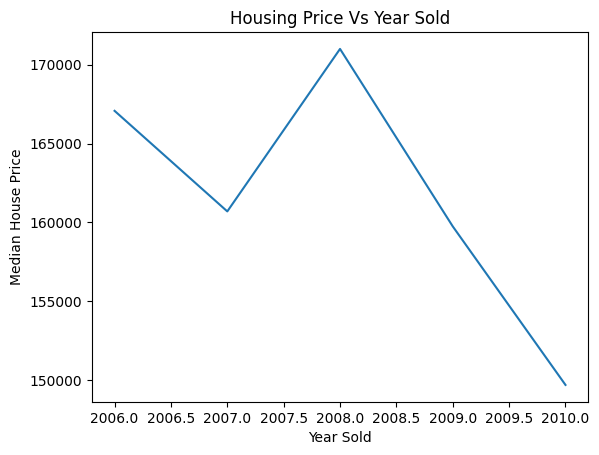

In [ ]:
#Analysing the temporal Datetime Variable:
df.groupby('YrSold')['SalePrice'].median().plot()
plt.xlabel("Year Sold")
plt.ylabel('Median House Price')
plt.title('Housing Price Vs Year Sold')

###The scatter plot above illustrates an exponential growth between each value on the x-axis and y-axis.

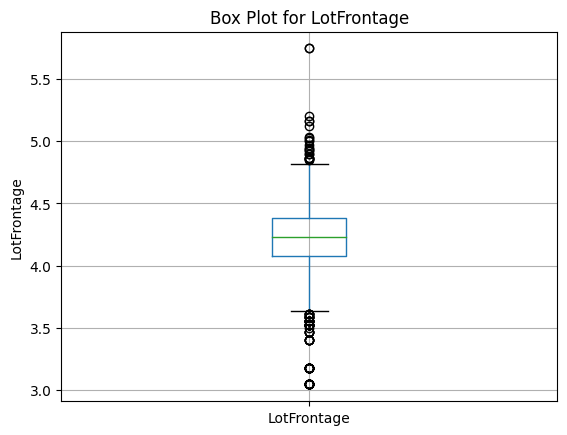

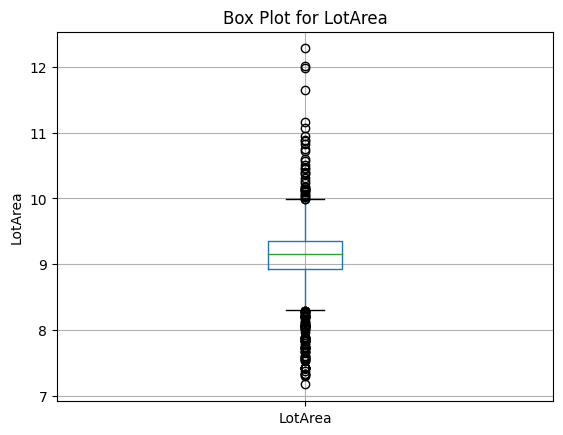

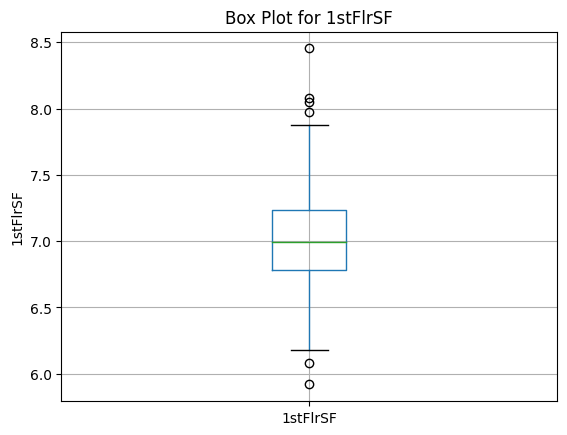

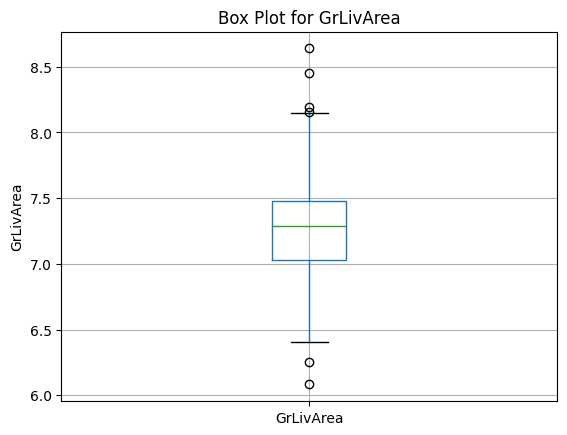

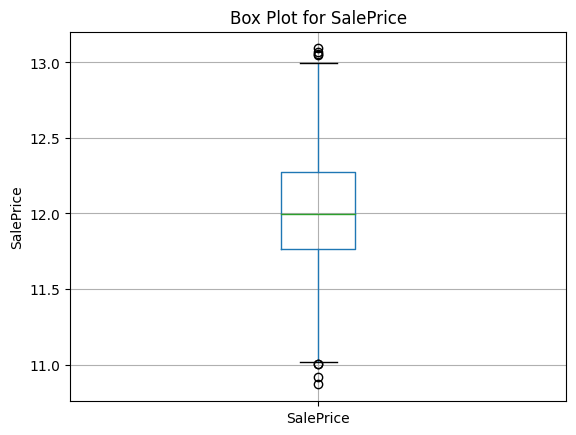

In [ ]:
#Finding the Outliers in the continous variables:
for feature in continous_variable:
  df1 = df.copy()
  if 0 in df1[feature].unique():
    pass
  else:
    df1[feature] = np.log(df1[feature])
    df1.boxplot(column = feature)
    plt.ylabel(feature)
    plt.title('Box Plot for ' + feature)
    plt.show()

###In the above Boxplots, we can see the outliers in the continuous variables with the dataset for each feature.  Lot Frontage has a large number of outliers and a small IQR as well as small zones in Q1, Q2, and Q3.

# Imputing Nan values in Numerical data with Mean
For columns with NaN values, there is a clear relationship between the missing values and the values.  In order to achieve a proper output, we need to fill these spaces with a reasonable value

In [ ]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,149,20,RL,63.0,7500,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1Story,7,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,BrkFace,120.0,TA,TA,PConc,Gd,TA,No,GLQ,680,Unf,0,400,1080,GasA,Ex,Y,SBrkr,1080,0,0,1080,1,0,1,0,3,1,Gd,6,Typ,0,NaN,NaN,NaN,NaN,0,0,NaN,NaN,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal,141000.0
1,460,50,RL,NaN,7015,Pave,NaN,IR1,Bnk,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,1.5Fin,5,4,1950,1950,Gable,CompShg,MetalSd,MetalSd,BrkCmn,161.0,TA,TA,CBlock,TA,TA,No,LwQ,185,Unf,0,524,709,GasA,TA,Y,SBrkr,979,224,0,1203,1,0,1,0,3,1,Gd,5,Typ,1,TA,Detchd,1950.0,Unf,1,352,TA,TA,Y,0,0,248,0,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal,110000.0
2,1336,20,RL,80.0,9650,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,5,1977,1977,Gable,CompShg,Plywood,Plywood,BrkFace,360.0,TA,TA,CBlock,Gd,TA,No,ALQ,686,Unf,0,664,1350,GasA,TA,Y,SBrkr,1334,0,0,1334,0,1,2,0,2,1,TA,6,Typ,1,TA,Attchd,1977.0,RFn,2,630,TA,TA,Y,0,16,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,Normal,167900.0
3,805,20,RL,75.0,9000,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1954,1954,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,LwQ,812,Unf,0,124,936,GasA,TA,Y,SBrkr,1128,0,0,1128,0,0,1,0,2,1,TA,5,Min1,0,NaN,Attchd,1954.0,Unf,1,286,TA,TA,Y,0,0,0,0,0,0,NaN,GdWo,NaN,0,6,2006,WD,Family,118000.0
4,1396,60,RL,88.0,12665,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,8,5,2005,2006,Hip,CompShg,VinylSd,VinylSd,BrkFace,245.0,Gd,TA,PConc,Gd,Gd,Gd,Unf,0,Unf,0,1094,1094,GasA,Ex,Y,SBrkr,1133,1349,0,2482,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2005.0,Fin,3,642,TA,TA,Y,144,39,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,281213.0


In [ ]:
numerical_features = [feature for feature in df.columns if df[feature].dtypes != 'O']
print(numerical_features)
imputer = SimpleImputer(strategy='mean')
imputer.fit(df[numerical_features])

df[numerical_features] = imputer.transform(df[numerical_features])
df[numerical_features].head()

['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice']


,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,149.0,20.0,63.000000,7500.0,7.0,5.0,2004.0,2005.0,120.0,680.0,0.0,400.0,1080.0,1080.0,0.0,0.0,1080.0,1.0,0.0,1.0,0.0,3.0,1.0,6.0,0.0,1978.402047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,2008.0,141000.0
1,460.0,50.0,69.908172,7015.0,5.0,4.0,1950.0,1950.0,161.0,185.0,0.0,524.0,709.0,979.0,224.0,0.0,1203.0,1.0,0.0,1.0,0.0,3.0,1.0,5.0,1.0,1950.000000,1.0,352.0,0.0,0.0,248.0,0.0,0.0,0.0,0.0,7.0,2009.0,110000.0
2,1336.0,20.0,80.000000,9650.0,6.0,5.0,1977.0,1977.0,360.0,686.0,0.0,664.0,1350.0,1334.0,0.0,0.0,1334.0,0.0,1.0,2.0,0.0,2.0,1.0,6.0,1.0,1977.000000,2.0,630.0,0.0,16.0,0.0,0.0,0.0,0.0,0.0,4.0,2009.0,167900.0
3,805.0,20.0,75.000000,9000.0,5.0,5.0,1954.0,1954.0,0.0,812.0,0.0,124.0,936.0,1128.0,0.0,0.0,1128.0,0.0,0.0,1.0,0.0,2.0,1.0,5.0,0.0,1954.000000,1.0,286.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,2006.0,118000.0
4,1396.0,60.0,88.000000,12665.0,8.0,5.0,2005.0,2006.0,245.0,0.0,0.0,1094.0,1094.0,1133.0,1349.0,0.0,2482.0,0.0,0.0,2.0,1.0,4.0,1.0,9.0,1.0,2005.000000,3.0,642.0,144.0,39.0,0.0,0.0,0.0,0.0,0.0,2.0,2007.0,281213.0


In [ ]:
for feature in numerical_features:
  print(feature,'with',np.round(df[feature].isnull().mean(),4),'% of NA')

Id with 0.0 % of NA
MSSubClass with 0.0 % of NA
LotFrontage with 0.0 % of NA
LotArea with 0.0 % of NA
OverallQual with 0.0 % of NA
OverallCond with 0.0 % of NA
YearBuilt with 0.0 % of NA
YearRemodAdd with 0.0 % of NA
MasVnrArea with 0.0 % of NA
BsmtFinSF1 with 0.0 % of NA
BsmtFinSF2 with 0.0 % of NA
BsmtUnfSF with 0.0 % of NA
TotalBsmtSF with 0.0 % of NA
1stFlrSF with 0.0 % of NA
2ndFlrSF with 0.0 % of NA
LowQualFinSF with 0.0 % of NA
GrLivArea with 0.0 % of NA
BsmtFullBath with 0.0 % of NA
BsmtHalfBath with 0.0 % of NA
FullBath with 0.0 % of NA
HalfBath with 0.0 % of NA
BedroomAbvGr with 0.0 % of NA
KitchenAbvGr with 0.0 % of NA
TotRmsAbvGrd with 0.0 % of NA
Fireplaces with 0.0 % of NA
GarageYrBlt with 0.0 % of NA
GarageCars with 0.0 % of NA
GarageArea with 0.0 % of NA
WoodDeckSF with 0.0 % of NA
OpenPorchSF with 0.0 % of NA
EnclosedPorch with 0.0 % of NA
3SsnPorch with 0.0 % of NA
ScreenPorch with 0.0 % of NA
PoolArea with 0.0 % of NA
MiscVal with 0.0 % of NA
MoSold with 0.0 % of NA


#Analysing features under Categorical Data



In [ ]:
from pandas.core.groupby import categorical
#features under categorical Feature
categorical_feature = [feature for feature in df.columns if df[feature].dtypes == 'O']
df[categorical_feature].head()

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN,NaN,WD,Normal
1,RL,Pave,NaN,IR1,Bnk,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,1.5Fin,Gable,CompShg,MetalSd,MetalSd,BrkCmn,TA,TA,CBlock,TA,TA,No,LwQ,Unf,GasA,TA,Y,SBrkr,Gd,Typ,TA,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,Plywood,Plywood,BrkFace,TA,TA,CBlock,Gd,TA,No,ALQ,Unf,GasA,TA,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,Wd Sdng,Wd Sdng,None,TA,TA,CBlock,TA,TA,No,LwQ,Unf,GasA,TA,Y,SBrkr,TA,Min1,NaN,Attchd,Unf,TA,TA,Y,NaN,GdWo,NaN,WD,Family
4,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,Hip,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,Gd,Gd,Unf,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,BuiltIn,Fin,TA,TA,Y,NaN,NaN,NaN,WD,Normal


In [ ]:
#printing unique categories in each feature.
for feature in categorical_feature:
  print('The feature is {} and the number of categories are {}'.format(feature,len(df[feature].unique())))

The feature is MSZoning and the number of categories are 5
The feature is Street and the number of categories are 2
The feature is Alley and the number of categories are 3
The feature is LotShape and the number of categories are 4
The feature is LandContour and the number of categories are 4
The feature is Utilities and the number of categories are 2
The feature is LotConfig and the number of categories are 5
The feature is LandSlope and the number of categories are 3
The feature is Neighborhood and the number of categories are 25
The feature is Condition1 and the number of categories are 9
The feature is Condition2 and the number of categories are 8
The feature is BldgType and the number of categories are 5
The feature is HouseStyle and the number of categories are 8
The feature is RoofStyle and the number of categories are 6
The feature is RoofMatl and the number of categories are 8
The feature is Exterior1st and the number of categories are 15
The feature is Exterior2nd and the numb

# Applying One hot encoding on the categorical data

In [ ]:
# STEP 1: Segregating Categorical data
categorical_feature = [feature for feature in df.columns if df[feature].dtypes == 'O']
print(len(categorical_feature))
df[categorical_feature].head()

43


,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,NaN,NaN,NaN,NaN,NaN,Y,NaN,NaN,NaN,WD,Normal
1,RL,Pave,NaN,IR1,Bnk,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,1.5Fin,Gable,CompShg,MetalSd,MetalSd,BrkCmn,TA,TA,CBlock,TA,TA,No,LwQ,Unf,GasA,TA,Y,SBrkr,Gd,Typ,TA,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,Plywood,Plywood,BrkFace,TA,TA,CBlock,Gd,TA,No,ALQ,Unf,GasA,TA,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,Wd Sdng,Wd Sdng,None,TA,TA,CBlock,TA,TA,No,LwQ,Unf,GasA,TA,Y,SBrkr,TA,Min1,NaN,Attchd,Unf,TA,TA,Y,NaN,GdWo,NaN,WD,Family
4,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,Hip,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,Gd,Gd,Unf,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,BuiltIn,Fin,TA,TA,Y,NaN,NaN,NaN,WD,Normal


In [ ]:
# Replace 'categorical_columns' with the list of the names of your categorical columns
df = pd.get_dummies(df, columns=categorical_feature, prefix=categorical_feature)

In [ ]:
df.head()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,Alley_Grvl,Alley_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_AllPub,Utilities_NoSeWa,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Ex,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_Po,FireplaceQu_TA,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_Fin,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Ex,GarageQual_Fa,GarageQual_Gd,GarageQ

# Modelling and Tuning
Here we are going to try three different models.
1.  Model 1 - 80% as Train from Training Data and 20% as Test from Training Data
2.  Model 2 - 100% of Training data as Train and Test.
3.  Model 3 - 80% as Train from Training Data and 20% as Test from Training Data

In Model 1 & Model 2, we will be using Feature subset selection and in Model 3 we will be using Sequential Feature Selection.

Note : Missed Modeling in the last draft.  Hence discussed Model 1 & 2 with Classmates for modeling and tuning in understanding whats required and what has to be done.

In [ ]:
#Separating Concated Train and Test Data before Modeling Train data

processed_train_df = df.iloc[:1000]
processed_test_df = df.iloc[1000:]
print(processed_train_df.shape)
print(processed_test_df.shape)

(1000, 290)
(446, 290)


In [ ]:
X = processed_train_df.drop(columns=['SalePrice'])
y = processed_train_df['SalePrice']

for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=38)

def processSubset(feature_set, X_train, y_train, X_test, y_test):
    model = sm.OLS(y_train,X_train[list(feature_set)])
    regr = model.fit()
    RMSE = float(np.sqrt(np.mean((regr.predict(X_test[list(feature_set)]) - y_test) ** 2)))
    return {'p':len(feature_set),'features':feature_set, 'model':regr, 'RMSE':RMSE}

def forward(predictors, X_train, y_train, X_test, y_test):
    remaining_predictors = [p for p in X_train.columns if p not in predictors]
    results = []
    for p in remaining_predictors:
        results.append(processSubset(predictors+[p], X_train, y_train, X_test, y_test))
    models = pd.DataFrame(results)

    print("-------")
    for i in range(len(models)):
      print(f" Option #{i}: {models['features'][i]}")
      print(f" RMSE: {round(models['RMSE'][i],1)}")
    best_model = models.loc[models['RMSE'].argmin()]
    return best_model

In [ ]:
models_train = pd.DataFrame(columns=['p', 'RMSE', 'features', 'model'])
predictors = []

for i in range(1, len(X.columns) + 1):
    models_train.loc[i] = forward(predictors, X_train, y_train, X_test, y_test)
    predictors = models_train.loc[i]['model'].model.exog_names

models_train['RMSE'] = models_train['RMSE'].astype(float)

Streaming output truncated to the last 5000 lines.
 RMSE: 18381.8
 Option #20: ['OverallQual', 'GarageCars', 'GarageFinish_Unf', 'GrLivArea', 'KitchenQual_Ex', 'BsmtFinSF1', 'Neighborhood_NoRidge', 'MSZoning_RM', 'SaleCondition_Abnorml', 'HeatingQC_Ex', 'LotArea', 'RoofMatl_ClyTile', 'BsmtExposure_Gd', 'KitchenQual_Gd', 'Neighborhood_Edwards', 'Neighborhood_NridgHt', 'Neighborhood_Crawfor', 'BsmtCond_Gd', 'BldgType_Duplex', 'Exterior1st_BrkFace', 'MSZoning_FV', 'Foundation_BrkTil', 'OverallCond', 'Foundation_CBlock', 'Id', 'Condition1_Artery', 'GarageFinish_RFn', 'LotConfig_FR3', 'BsmtExposure_Mn', 'ExterQual_TA', 'Functional_Typ', 'LandContour_HLS', 'WoodDeckSF', 'OpenPorchSF', 'Neighborhood_BrkSide', 'LotFrontage', 'MasVnrArea', 'RoofMatl_WdShngl', 'LotShape_IR3', 'LotShape_IR1', 'LowQualFinSF', 'Exterior1st_Stucco', 'Exterior1st_VinylSd', 'GarageFinish_Fin', 'Neighborhood_OldTown', 'BsmtFinType1_ALQ', 'Neighborhood_Timber', 'Neighborhood_ClearCr', 'Condition1_Feedr', 'BsmtFinType2_R

In [ ]:
models_train

,p,RMSE,features,model
1,1,44333.831871,[OverallQual],<statsmodels.regression.linear_model.Regressio...
2,2,38792.904571,"[OverallQual, GarageCars]",<statsmodels.regression.linear_model.Regressio...
3,3,35261.061431,"[OverallQual, GarageCars, GarageFinish_Unf]",<statsmodels.regression.linear_model.Regressio...
4,4,31533.857310,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...
5,5,28893.075747,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...
...,...,...,...,...
285,285,23466.454059,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...
286,286,23499.425714,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...
287,287,24469.825726,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...
288,288,24462.806737,"[OverallQual, GarageCars, GarageFinish_Unf, Gr...",<statsmodels.regression.linear_model.Regressio...


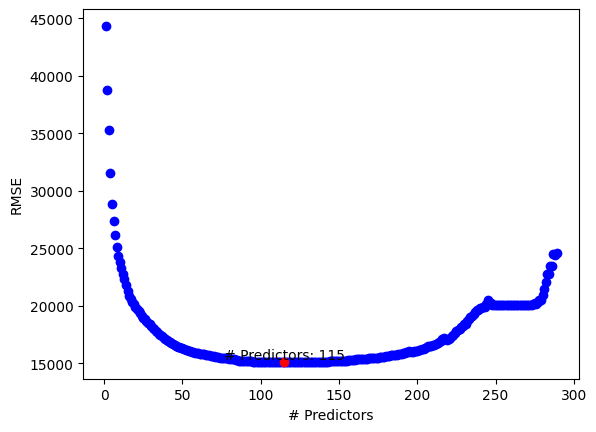

In [ ]:
import matplotlib.pyplot as plt
plt.plot(models_train['RMSE'], 'ob')

plt.xlabel('# Predictors')
plt.ylabel('RMSE')

min_rmse_index = models_train['RMSE'].astype(float).idxmin()
min_rmse = models_train['RMSE'].min()
plt.plot(min_rmse_index, min_rmse, 'or')

min_predictors = models_train['p'][min_rmse_index]
plt.text(min_rmse_index, min_rmse, f'# Predictors: {min_predictors}', va='bottom', ha='center')

plt.show()

In [ ]:
#Model 2 - No Test set.  100% of training set is used as train and test
models_no_test = pd.DataFrame(columns=['p','RMSE','features', 'model'])
predictors = []

for i in range(1, len(X.columns) + 1):
    models_no_test.loc[i] = forward(predictors, X, y, X, y)
    predictors = models_no_test.loc[i]['model'].model.exog_names

models_no_test['RMSE'] = models_no_test['RMSE'].astype(float)

Streaming output truncated to the last 5000 lines.
 RMSE: 18056.3
 Option #20: ['OverallQual', 'GarageCars', 'BsmtQual_Ex', 'GrLivArea', 'ExterQual_TA', 'RoofMatl_ClyTile', 'BsmtFinSF1', 'MSSubClass', 'Condition2_PosN', 'BsmtExposure_Gd', 'KitchenQual_Ex', 'SaleType_New', 'LotArea', 'Neighborhood_NridgHt', 'Neighborhood_NoRidge', 'Neighborhood_OldTown', 'OverallCond', 'BedroomAbvGr', 'BsmtQual_Gd', 'Exterior1st_BrkFace', 'RoofMatl_WdShngl', 'Neighborhood_StoneBr', 'YrSold', 'YearBuilt', 'Neighborhood_Crawfor', 'Neighborhood_Somerst', 'SaleCondition_Normal', 'TotalBsmtSF', 'BldgType_1Fam', 'BsmtExposure_No', 'Functional_Typ', 'Fireplaces', 'Condition1_Norm', 'ExterQual_Ex', 'LotConfig_CulDSac', 'WoodDeckSF', 'ScreenPorch', 'Foundation_PConc', 'BsmtFullBath', 'LotShape_IR1', 'BldgType_2fmCon', 'Condition1_RRAe', 'Exterior2nd_Wd Shng', 'Neighborhood_Edwards', 'Exterior1st_Stucco', 'LotShape_Reg', 'SaleType_Con', 'SaleCondition_Partial', 'Exterior1st_HdBoard', 'Neighborhood_NAmes', 'LandCo

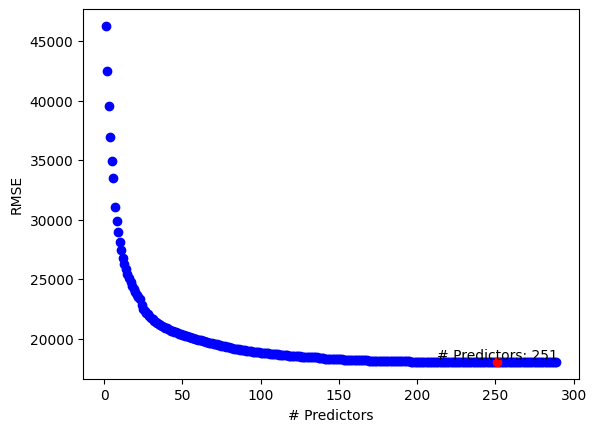

In [ ]:
import matplotlib.pyplot as plt

# Plot RMSE against the number of predictors
plt.plot(models_no_test['RMSE'], 'ob')

plt.xlabel('# Predictors')
plt.ylabel('RMSE')

# Plot only the minimum RMSE point with a red circle marker
min_rmse_index = models_no_test['RMSE'].astype(float).idxmin()
min_rmse = models_no_test['RMSE'].min()
plt.plot(min_rmse_index, min_rmse, 'or')

# Add a label for the number of predictors for the red dot
min_predictors = models_no_test['p'][min_rmse_index]
plt.text(min_rmse_index, min_rmse, f'# Predictors: {min_predictors}', va='bottom', ha='center')

plt.show()

In [ ]:
#print best subset combination
print("Best 115 variables from our training set")
print(sorted(models_train.loc[115, 'model'].model.exog_names))

print("--------")
print("Best 115 variables from full set")
print(sorted(models_no_test.loc[115, 'model'].model.exog_names))

Best 115 variables from our training set
['Alley_Grvl', 'BedroomAbvGr', 'BldgType_Duplex', 'BsmtCond_Gd', 'BsmtCond_Po', 'BsmtExposure_Gd', 'BsmtExposure_Mn', 'BsmtFinSF1', 'BsmtFinType1_ALQ', 'BsmtFinType1_Unf', 'BsmtFinType2_GLQ', 'BsmtFinType2_Rec', 'BsmtHalfBath', 'BsmtQual_TA', 'Condition1_Artery', 'Condition1_Feedr', 'Condition2_Artery', 'Condition2_PosA', 'Condition2_RRAe', 'Electrical_FuseA', 'Electrical_FuseF', 'Electrical_FuseP', 'ExterCond_Gd', 'ExterCond_TA', 'ExterQual_TA', 'Exterior1st_BrkFace', 'Exterior1st_ImStucc', 'Exterior1st_Stone', 'Exterior1st_Stucco', 'Exterior1st_VinylSd', 'Exterior1st_Wd Sdng', 'Exterior2nd_BrkFace', 'Exterior2nd_CmentBd', 'Exterior2nd_Other', 'Exterior2nd_Plywood', 'Exterior2nd_Stone', 'Fence_GdWo', 'Fence_MnWw', 'FireplaceQu_Fa', 'FireplaceQu_Gd', 'FireplaceQu_Po', 'FireplaceQu_TA', 'Foundation_BrkTil', 'Foundation_CBlock', 'Foundation_Wood', 'FullBath', 'Functional_Mod', 'Functional_Typ', 'GarageCars', 'GarageCond_Gd', 'GarageFinish_Fin', 'G

Using Linear regression to predict the SalePrice using the Variables Subset from the Full set with no validation set

In [ ]:
# Check and add missing columns in processed_test_df from processed_train_df
missing_columns_test = set(processed_train_df.columns) - set(processed_test_df.columns)
for column in missing_columns_test:
    processed_test_df[column] = 0

In [ ]:
# Model 1
#Calculator.py --> Training split as train and test
column_selection = ['Alley_Grvl', 'BedroomAbvGr', 'BldgType_Duplex', 'BsmtCond_Gd', 'BsmtCond_Po', 'BsmtExposure_Gd', 'BsmtExposure_Mn', 'BsmtFinSF1', 'BsmtFinType1_ALQ', 'BsmtFinType1_Unf', 'BsmtFinType2_GLQ', 'BsmtFinType2_Rec', 'BsmtHalfBath', 'BsmtQual_TA', 'Condition1_Artery', 'Condition1_Feedr', 'Condition2_Artery', 'Condition2_PosA', 'Condition2_RRAe', 'Electrical_FuseA', 'Electrical_FuseF', 'Electrical_FuseP', 'ExterCond_Gd', 'ExterCond_TA', 'ExterQual_TA', 'Exterior1st_BrkFace', 'Exterior1st_ImStucc', 'Exterior1st_Stone', 'Exterior1st_Stucco', 'Exterior1st_VinylSd', 'Exterior1st_Wd Sdng', 'Exterior2nd_BrkFace', 'Exterior2nd_CmentBd', 'Exterior2nd_Other', 'Exterior2nd_Plywood', 'Exterior2nd_Stone', 'Fence_GdWo', 'Fence_MnWw', 'FireplaceQu_Fa', 'FireplaceQu_Gd', 'FireplaceQu_Po', 'FireplaceQu_TA', 'Foundation_BrkTil', 'Foundation_CBlock', 'Foundation_Wood', 'FullBath', 'Functional_Mod', 'Functional_Typ', 'GarageCars', 'GarageCond_Gd', 'GarageFinish_Fin', 'GarageFinish_RFn', 'GarageFinish_Unf', 'GarageQual_Ex', 'GarageType_BuiltIn', 'GrLivArea', 'HeatingQC_Ex', 'Heating_Floor', 'HouseStyle_1.5Fin', 'HouseStyle_1.5Unf', 'HouseStyle_SLvl', 'Id', 'KitchenQual_Ex', 'KitchenQual_Gd', 'LandContour_HLS', 'LandContour_Lvl', 'LotArea', 'LotConfig_Corner', 'LotConfig_CulDSac', 'LotConfig_FR2', 'LotConfig_FR3', 'LotFrontage', 'LotShape_IR1', 'LotShape_IR3', 'LowQualFinSF', 'MSZoning_FV', 'MSZoning_RM', 'MasVnrArea', 'MasVnrType_None', 'MiscFeature_Gar2', 'MoSold', 'Neighborhood_BrDale', 'Neighborhood_BrkSide', 'Neighborhood_ClearCr', 'Neighborhood_CollgCr', 'Neighborhood_Crawfor', 'Neighborhood_Edwards', 'Neighborhood_MeadowV', 'Neighborhood_NWAmes', 'Neighborhood_NoRidge', 'Neighborhood_NridgHt', 'Neighborhood_OldTown', 'Neighborhood_Sawyer', 'Neighborhood_SawyerW', 'Neighborhood_Timber', 'Neighborhood_Veenker', 'OpenPorchSF', 'OverallCond', 'OverallQual', 'PavedDrive_Y', 'PoolArea', 'RoofMatl_ClyTile', 'RoofMatl_Membran', 'RoofMatl_WdShake', 'RoofMatl_WdShngl', 'RoofStyle_Flat', 'SaleCondition_Abnorml', 'SaleType_COD', 'SaleType_CWD', 'SaleType_Con', 'SaleType_ConLD', 'SaleType_ConLI', 'SaleType_ConLw', 'Utilities_NoSeWa', 'WoodDeckSF']


X = processed_train_df[column_selection]
y = processed_train_df['SalePrice']

# fill missing values based on probability of occurrence
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())

#LINEAR REGRESSION
model = LinearRegression()
model.fit(X,y) #this fits the model


#Prediction
X = processed_train_df[column_selection]
y = processed_train_df['SalePrice']
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())
predictions = model.predict(X)
test_df = processed_test_df
X = processed_test_df[column_selection]
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())
predictions = model.predict(X)


#Final Output for Model 1 :
list_predictions = predictions.tolist()
rounded_list_predictions = [int(x) for x in list_predictions]
print(rounded_list_predictions)

[201916, 145204, 108786, 164959, 133104, 269144, 63581, 187550, 157794, 164455, 133248, 302084, 238255, 166644, 157302, 341732, 120255, 181067, 211342, 51907, 110169, 182480, 167011, 191691, 137007, 124432, 192057, 191322, 194415, 120609, 132907, 146630, 308966, 228679, 179468, 166296, 107936, 174451, 225336, 205182, 148806, 148334, 204416, 137327, 146945, 95194, 138164, 228473, 261808, 179770, 264358, 127761, 118587, 194765, 194995, 191713, 126137, 207179, 156718, 145424, 104800, 124936, 172230, 117662, 216897, 243109, 178082, 198250, 282576, 90145, 233709, 243471, 89841, 234341, 198677, 212321, 106927, 182096, 157345, 152745, 137642, 207868, 219133, 224674, 142800, 240728, 259424, 141664, 282920, 176355, 185669, 197081, 321761, 147047, 174068, 103026, 118877, 200593, 135961, 85503, 196172, 131797, 290000, 169033, 118946, 124693, 204039, 149405, 260044, 295228, 203101, 202327, 74775, 131967, 105483, 126672, 160618, 227352, 254414, 303561, 249566, 204684, 315689, 136591, 105333, 191073

In [ ]:
#RMSE Score : 25878

In [ ]:
# Model 2:
#Calculator.py -->  Training tested against training. No test validation provided here.
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
column_selection =['BedroomAbvGr', 'BldgType_1Fam', 'BldgType_2fmCon', 'BldgType_Duplex', 'BsmtCond_Po', 'BsmtExposure_Gd', 'BsmtExposure_No', 'BsmtFinSF1', 'BsmtFinType1_ALQ', 'BsmtFinType2_GLQ', 'BsmtFullBath', 'BsmtQual_Ex', 'BsmtQual_Gd', 'BsmtUnfSF', 'Condition1_Artery', 'Condition1_Norm', 'Condition1_RRAe', 'Condition1_RRAn', 'Condition2_Artery', 'Condition2_PosN', 'Electrical_FuseF', 'ExterCond_Gd', 'ExterQual_Ex', 'ExterQual_Gd', 'ExterQual_TA', 'Exterior1st_BrkFace', 'Exterior1st_HdBoard', 'Exterior1st_MetalSd', 'Exterior1st_Stucco', 'Exterior1st_WdShing', 'Exterior2nd_AsbShng', 'Exterior2nd_AsphShn', 'Exterior2nd_Plywood', 'Exterior2nd_Stone', 'Exterior2nd_Wd Shng', 'Fence_GdPrv', 'FireplaceQu_Fa', 'FireplaceQu_Gd', 'FireplaceQu_TA', 'Fireplaces', 'Foundation_BrkTil', 'Foundation_PConc', 'Foundation_Wood', 'Functional_Maj2', 'Functional_Typ', 'GarageArea', 'GarageCars', 'GarageCond_Ex', 'GarageCond_Fa', 'GarageCond_Po', 'GarageCond_TA', 'GarageQual_Ex', 'GarageQual_Gd', 'GarageType_2Types', 'GarageType_Detchd', 'GrLivArea', 'HeatingQC_Gd', 'HeatingQC_TA', 'Heating_OthW', 'HouseStyle_2.5Fin', 'HouseStyle_2.5Unf', 'KitchenQual_Ex', 'LandContour_Bnk', 'LandContour_HLS', 'LandSlope_Sev', 'LotArea', 'LotConfig_CulDSac', 'LotConfig_FR2', 'LotConfig_FR3', 'LotFrontage', 'LotShape_IR1', 'LotShape_Reg', 'LowQualFinSF', 'MSSubClass', 'MSZoning_C (all)', 'MasVnrArea', 'MoSold', 'Neighborhood_Blmngtn', 'Neighborhood_BrDale', 'Neighborhood_ClearCr', 'Neighborhood_Crawfor', 'Neighborhood_Edwards', 'Neighborhood_Mitchel', 'Neighborhood_NAmes', 'Neighborhood_NPkVill', 'Neighborhood_NoRidge', 'Neighborhood_NridgHt', 'Neighborhood_OldTown', 'Neighborhood_SawyerW', 'Neighborhood_Somerst', 'Neighborhood_StoneBr', 'Neighborhood_Timber', 'Neighborhood_Veenker', 'OverallCond', 'OverallQual', 'PoolQC_Gd', 'RoofMatl_ClyTile', 'RoofMatl_CompShg', 'RoofMatl_Membran', 'RoofMatl_WdShngl', 'RoofStyle_Mansard', 'SaleCondition_Normal', 'SaleCondition_Partial', 'SaleType_CWD', 'SaleType_Con', 'SaleType_ConLD', 'SaleType_New', 'ScreenPorch', 'Street_Grvl', 'TotalBsmtSF', 'Utilities_AllPub', 'WoodDeckSF', 'YearBuilt', 'YearRemodAdd', 'YrSold']

X = processed_train_df[column_selection]
y = processed_train_df['SalePrice']

# fill missing values based on probability of occurrence
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())

#LINEAR REGRESSION
model = LinearRegression()
model.fit(X,y) #this fits the model

#Prediction
X = processed_train_df[column_selection]
y = processed_train_df['SalePrice']
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())
predictions = model.predict(X)
test_df = processed_test_df
X = processed_test_df[column_selection]
for column in X.columns:
    null_vals = X.isnull().values
    a, b = np.unique(X.values[~null_vals], return_counts = 1)
    X.loc[X[column].isna(), column] = np.random.choice(a, X[column].isnull().sum(), p = b / b.sum())
predictions = model.predict(X)

#Final Output for Model 2 :
list_predictions = predictions.tolist()
rounded_list_predictions = [int(x) for x in list_predictions]
print(rounded_list_predictions)

[217097, 139163, 118074, 135141, 126810, 259227, 65737, 183244, 157126, 173820, 143560, 301860, 269563, 180553, 145662, 429264, 126652, 162368, 214671, 58025, 113033, 186854, 158473, 189632, 124860, 115360, 189717, 206559, 179957, 118235, 130032, 150221, 331766, 242514, 165283, 169693, 113269, 140236, 213325, 211392, 159043, 156863, 201050, 115561, 127978, 109931, 135713, 224681, 278079, 185732, 270268, 148656, 128691, 198732, 173530, 168963, 109107, 191542, 135799, 125264, 93983, 89771, 169285, 114836, 213076, 242534, 186791, 219162, 277945, 84382, 217255, 248622, 91612, 232645, 183698, 206155, 121822, 186284, 121037, 159304, 139057, 186184, 231877, 225889, 123008, 244158, 256766, 149115, 270868, 164627, 179752, 182619, 327524, 147957, 116562, 85585, 121346, 208606, 146806, 93280, 205507, 126646, 299410, 161900, 119216, 110626, 198204, 149481, 254496, 358620, 216285, 203551, 60736, 143989, 105830, 147739, 139720, 213907, 256022, 309473, 259384, 203416, 309095, 149080, 107465, 208355, 

In [ ]:
# RMSE Score : 27142

# OVERFITTING Vs UNDERFITTING

From Model 1 & Model 2, we can clearly say that the Model 1 is OverFitting and Model 2 is underfitting.  Also, if you look at the number of features provided for each category its

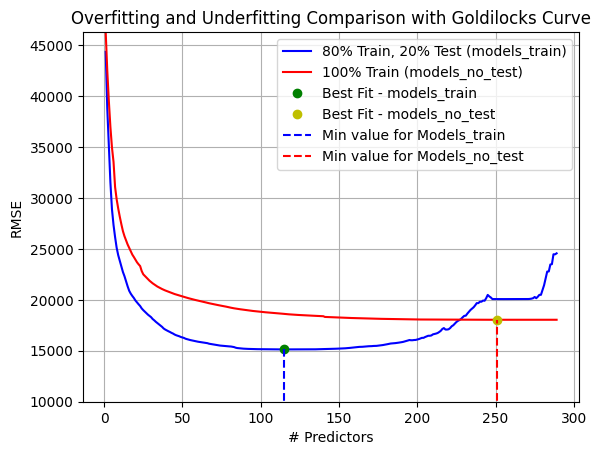

In [ ]:
models_no_test['RMSE'] = models_no_test['RMSE'].astype(float)
import matplotlib.pyplot as plt

predictors_train = models_train['p']
rmse_train = models_train['RMSE']
predictors_no_test = models_no_test['p']
rmse_no_test = models_no_test['RMSE']

# RMSE Plotting Against Model 1 & Model 2
plt.plot(predictors_train, rmse_train, 'b-', label='TRAIN-80%, TEST-20%  (Model-1-->models_train)')
plt.plot(predictors_no_test, rmse_no_test, 'r-', label='100% Train (Model-2-->no_test)')

# Goldilocks curve for the best fit (models_train)
min_rmse_index_train = rmse_train.idxmin()
min_rmse_predictors_train = predictors_train[min_rmse_index_train]
min_rmse_train = rmse_train[min_rmse_index_train]
plt.plot(min_rmse_predictors_train, min_rmse_train, 'og', label='Best Fit - models_train')

# Goldilocks curve for the best fit (models_no_test)
min_rmse_index_no_test = rmse_no_test.idxmin()
min_rmse_predictors_no_test = predictors_no_test[min_rmse_index_no_test]
min_rmse_no_test = rmse_no_test[min_rmse_index_no_test]
plt.plot(min_rmse_predictors_no_test, min_rmse_no_test, 'oy', label='Best Fit - no_test')

# Min value for Models of Goldilocks curve
plt.plot([min_rmse_predictors_train, min_rmse_predictors_train], [0, min_rmse_train], 'b--', label='Min value for (Model-1)Models_train')
plt.plot([min_rmse_predictors_no_test, min_rmse_predictors_no_test], [0, min_rmse_no_test], 'r--', label='Min value for (Model-2)Models_no_test')

plt.xlabel('# Predictors')
plt.ylabel('RMSE')

# Set the y-axis limits
plt.ylim(10000, max(max(rmse_train), max(rmse_no_test)))

plt.legend()
plt.title('Overfitting and Underfitting Comparison with Goldilocks Curve')
plt.grid(True)

plt.show()


In [ ]:
# Model 3 --> Sequential Feature Selection and calculating MSE
selected_features = []
remaining_features = list(X.columns)
feature_scores = []  # Store the MSE for each feature combination

# Iterate through features
while len(remaining_features) > 0:
    best_mse = float('inf')  # Initialize with a high value
    best_feature = None

    for feature in remaining_features:
        # Create a new feature set by adding the current feature
        candidate_features = selected_features + [feature]

        # Train a model with the candidate features
        model = LinearRegression()
        model.fit(X_train[candidate_features], y_train)
        y_pred = model.predict(X_test[candidate_features])

        # Evaluate the model using the Mean Squared Error (MSE)
        mse = mean_squared_error(y_test, y_pred)
        feature_scores.append((feature, mse))  # Store feature and its MSE

        # If the model with the current feature is better, update the best feature and MSE
        if mse < best_mse:
            best_mse = mse
            best_feature = feature

    # Add the best feature to the selected features set
    selected_features.append(best_feature)

    # Remove the best feature from the remaining features list
    remaining_features.remove(best_feature)

# Print feature scores
for feature, score in feature_scores:
    print(f"Feature: {feature}, MSE: {score}")


Streaming output truncated to the last 5000 lines.
Feature: RoofMatl_CompShg, MSE: 245075240.622183
Feature: RoofMatl_Tar&Grv, MSE: 245075240.62148857
Feature: Exterior1st_BrkComm, MSE: 241867913.01783934
Feature: Exterior1st_CemntBd, MSE: 245567638.24396178
Feature: Exterior1st_MetalSd, MSE: 250031789.30410126
Feature: Exterior1st_Plywood, MSE: 238123047.91006696
Feature: Exterior2nd_BrkFace, MSE: 238382470.03424796
Feature: Exterior2nd_CmentBd, MSE: 242990326.57986808
Feature: Exterior2nd_HdBoard, MSE: 243504777.98487976
Feature: Exterior2nd_ImStucc, MSE: 240506139.63883954
Feature: Exterior2nd_MetalSd, MSE: 258309038.5877984
Feature: Exterior2nd_VinylSd, MSE: 239873409.33166862
Feature: Exterior2nd_Wd Shng, MSE: 250406923.09202737
Feature: MasVnrType_BrkFace, MSE: 239765181.9896566
Feature: MasVnrType_Stone, MSE: 242795777.23876664
Feature: ExterQual_Ex, MSE: 260428598.0461794
Feature: ExterQual_Fa, MSE: 260428598.04629982
Feature: Foundation_BrkTil, MSE: 237863838.6083483
Feature: 

In [ ]:
print(len(selected_features))
print(len(remaining_features))

289
0


We are going to use Model 3's features for our final Model cause they give the best RMSE value.

In [ ]:
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
model = LinearRegression()
model.fit(X,y)

LinearRegression()

In [ ]:
common_columns = X_train.columns.intersection(processed_test_df.columns)
processed_test_df = processed_test_df[common_columns]
processed_test_df.shape

#Predict on the test set
m = processed_test_df
predictions = model.predict(m)

#FINAL RMSE Value : 22823

This concludes the Ames Housing data analysis and prediction. We explored the dataset and pre-processed data wherever necessary.  Then followed it by Imputing the values for numerical and categorical values.  We tried three different models to check which gave the best RMSE. After Running the models we can conclude that model 3 gave the best RMSE value.  Also, Model 1 & 2 acted as a very good example of underfitting Vs Overfitting.